<a href="https://www.kaggle.com/code/anshtanwar/japan-life-expectancy-eda-autoviz?scriptVersionId=138508681" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# <div style="border-radius:10px; border:#E57C23 solid; padding: 15px; background-color: #FFFAF0; font-size:100%; text-align:left"> **<center>📊 Real-Time Interactive EDA in just Few Lines 📊<center/>**


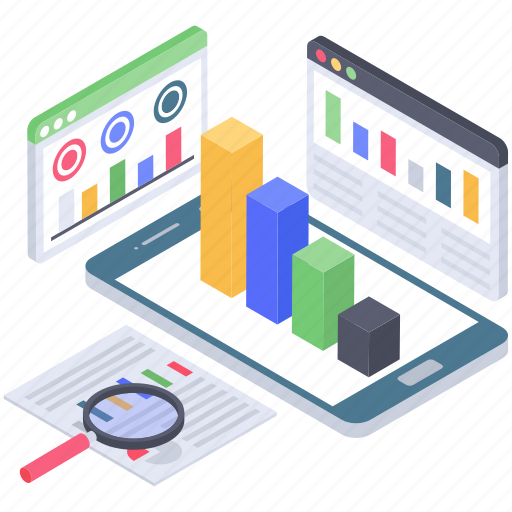

## <div style="border-radius:10px; border:#E57C23 solid; padding: 15px; background-color: #FFFAF0; font-size:100%; text-align:center">Dont forget to upvote if you liked the notebook</div>

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
df = pd.read_csv('/kaggle/input/japan-life-expectancy/Japan_life_expectancy.csv')
df.head()

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


,Prefecture,Life_expectancy,Physician,Junior_col,University,Public_Hosp,Pshic_hosp,Beds_psic,Nurses,Avg_hours,...,Park,Forest,Income_per capita,Density_pop,Hospitals,Beds,Ambulances,Health_exp,Educ_exp,Welfare_exp
0,Aichi,84.65,224.4,13.6,23.7,13.7,0.5,164.3,845.4,171.5,...,17.2,42.1,3728.0,2517.7,3.8,758.7,3.7,2.06,21.41,16.53
1,Akita,83.79,242.6,11.3,11.9,34.0,1.7,404.6,1105.5,173.0,...,10.6,70.3,2697.0,296.8,5.2,1168.5,9.0,3.24,17.93,13.50
2,Aomori,82.80,212.5,11.4,11.8,42.9,1.4,348.7,1108.8,174.5,...,11.8,63.6,2507.0,380.5,6.2,1112.8,9.1,3.40,20.98,15.92
3,Chiba,84.48,205.8,14.7,24.9,16.1,0.5,195.8,749.1,173.5,...,5.5,30.1,3116.0,1778.4,4.1,806.2,4.2,3.53,25.44,18.24
4,Ehime,84.24,276.7,14.2,18.0,17.4,1.0,329.7,1277.5,178.0,...,7.2,70.5,2658.0,801.2,9.1,1274.2,7.1,4.82,20.47,15.60


# <div style="border-radius:10px; border:#E57C23 solid; padding: 15px; background-color: #FFFAF0; font-size:100%; text-align:left">INSTALLATION💽

In [2]:
!python3 -m pip install autoviz geopandas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.5/18.5 MB 50.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 38.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 59.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 53.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.5/96.5 kB 7.5 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of panel to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 42.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 39.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 50.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 51.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.9/19.9 

# <div style="border-radius:10px; border:#E57C23 solid; padding: 15px; background-color: #FFFAF0; font-size:100%; text-align:left">Plot the geographical visualization using Plotly</div>

In [3]:
import geopandas as gpd
import pandas as pd
import plotly.express as px

# Load the GeoJSON file for Japan
japan_geo = '/kaggle/input/japan-life-expectancy/japan.geojson'
gdf = gpd.read_file(japan_geo)

# Clean the 'nam' column by taking only the first part of the names
gdf.nam = gdf.nam.str.split().str[0]

# Merge the GeoDataframe with the previous DataFrame
merged_data = gdf.merge(df, left_on='nam', right_on='Prefecture', how='inner')

# Plot the geographical visualization using Plotly
fig = px.choropleth_mapbox(
    merged_data,
    geojson=merged_data.geometry,
    locations=merged_data.index,
    color='Life_expectancy',
    color_continuous_scale='plasma',
    mapbox_style='carto-positron',
    hover_name='Prefecture',
    hover_data=[ 'Life_expectancy', 'Physician', 'Junior_col',
       'University', 'Public_Hosp', 'Pshic_hosp', 'Beds_psic', 'Nurses',
       'Avg_hours', 'Salary', 'Elementary_school', 'Sport_fac', 'Park',
       'Forest', 'Income_per capita', 'Density_pop', 'Hospitals', 'Beds',
       'Ambulances', 'Health_exp', 'Educ_exp', 'Welfare_exp'],  # Add more columns to display in the hover tooltip
    center={'lat': 36, 'lon': 138},
    zoom=4.5,
    opacity=0.7,
    labels={'Life_expectancy': 'Life Expectancy'}
)

# Update the map layout to add a title, adjust margins, and show the legend
fig.update_layout(
    title_text='Life Expectancy in Japan by Prefecture: Hover on the map to see detailed information',
    margin={'r': 20, 't': 40, 'l': 20, 'b': 0},
    legend=dict(title='Life Expectancy'),
)

# Show the interactive plot
fig.show()


<div style="border-radius:10px; border:#E57C23 solid; padding: 15px; background-color: #FFFAF0; font-size:100%; text-align:left">
    
    
    
<div style="background-color:#fff1cc">Feed AutoViz any input filename (in CSV, txt, or JSON format), and set max_rows_analyzed and max_cols_analyzed based on memory limitations in your environment, and watch the magic happen!

AutoViz can now create charts in multiple formats using the chart_format setting:<br><br>

* If chart_format ='png' or 'svg' or 'jpg': Matplotlib charts are plotted inline.<br>
* Can be saved locally (using verbose=2 setting) or displayed (verbose=1) in Jupyter Notebooks.<br>
* This is the default behavior for AutoViz.<br>
* If chart_format='bokeh': Interactive Bokeh charts are plotted in Jupyter Notebooks.<br>
* If chart_format='server', dashboards will pop up for each kind of chart on your browser.<br>
* If chart_format='html', interactive Bokeh charts will be created and silently saved as HTML files under the AutoViz_Plots directory (under working folder) or any other directory that you specify using the save_plot_dir setting (during input). </div>
</div>



# <div style="border-radius:10px; border:#E57C23 solid; padding: 15px; background-color: #FFFAF0; font-size:100%; text-align:left">📉📈Generate interactive Bokeh charts and save them as HTML files in a custom directory</div>

In [4]:
from autoviz import AutoViz_Class
AV = AutoViz_Class()
filename = "/kaggle/input/japan-life-expectancy/Japan_life_expectancy.csv"
target_variable = "Life_expectancy"
custom_plot_dir = "custom_plot_directory"

dft = AV.AutoViz(
    filename,
    sep=",",
    depVar=target_variable,
    dfte=None,
    header=0,
    verbose=1,
    lowess=False,
    chart_format="html",
    max_rows_analyzed=100,
    max_cols_analyzed=30,
    save_plot_dir=custom_plot_dir
)

Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Shape of your Data Set loaded: (47, 23)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    22 Predictors classified...
        1 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['Prefecture']

################ Regression problem #####################
Saving scatterplots in HTML format
Saving pair_scatters in HTML format
Saving distplots_nums in HTML format
Saving kd

# <div style="border-radius:10px; border:#E57C23 solid; padding: 15px; background-color: #FFFAF0; font-size:100%; text-align:left">Load Html Bokeh charts and Interact with them in real-time</div>

In [5]:
from IPython.core.display import display, HTML

# Define the list of file names
file_names = ['distplots_nums.html','scatterplots.html','pair_scatters.html','kde_plots.html','violinplots.html', 'kde_plots.html', 'heatmaps.html']  # Add all the file names

# Loop through the list and display each HTML file
for file_name in file_names:
    file_path = f'/kaggle/working/custom_plot_directory/Life_expectancy/{file_name}'
    with open(file_path, 'r') as file:
        html_content = file.read()
        display(HTML(html_content))
